## Crack Prompting

This notebook demonstrates how to use a Visual Prompting model to differentiate cracked portion of a concrete surface

In particular, we are going to show you:

1. How to use the `Predictor` class to extract the segmentation mask
2. How to visualize the segmentation mask
3. How to extract the percentage pixel coverage and visualize it in a pie chart

### Installation

In [1]:
!pip install landingai

### Prerequisite: Deploy a Visual Prompting Model

Before performing the coverage analsis, we have already trained a Visual Prompting model in LandingLens, and deployed it to a web endpoint via [Cloud Deployment](https://support.landing.ai/landinglens/docs/cloud-deployment).

The following cell includes the credentials needed to access the model and its endpoint: endpoint_id, api_key, and api_secret.

In [2]:
#@title Set the following variables as needed for your setup
api_key = "e66v1bcl38ciaxcxdz139r8y1mehmir"
api_secret = "lywm52n3ekpczlpkfejj9c1b7327rg65j4npmdzlilu3ynrvjk4y1gph03m2he"
endpoint_id = "0f08cd2f-514f-4533-b7b4-2ae8f2ff27cd"

### Load Images

Here, we load three test images for the crack analysis.

In [5]:
import numpy as np
from PIL import Image as PILImage

images = [
    np.asarray(PILImage.open("sample_images2/1.jpg")),
    np.asarray(PILImage.open("sample_images2/2.jpg")),
    np.asarray(PILImage.open("sample_images2/3.jpg"))
]

### Example Image

Let's take a look at one of the test images.

The model is trained to detect two classes:

1. Cracked Portion
2. Uncracked Surface

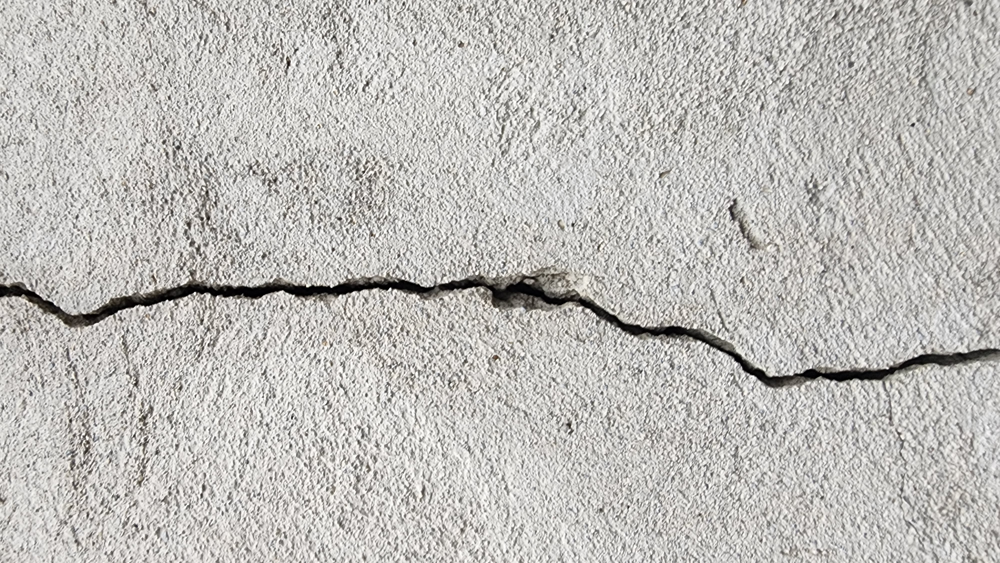

In [6]:
display(PILImage.fromarray(images[0]))

### Run Inference

In the following cell, we use the `Predictor` call to get the predicted segmentation masks for each image.

The predictor returns a list of `SegmentationPrediction` instances for each image.

We collect all of the prediction results into a list for further processing. 

In [7]:
from landingai.predict import Predictor

predictor = Predictor(endpoint_id, api_key, api_secret)
predictions = []
for img in images:
        predictions.extend(predictor.predict(img))

### Example Image with Prediction

Before moving forward, it's helpful to do a sanity check to see if the prediction result looks reasonable to you.  

To do that, we get the predictions of a single image, and visualize it like below.

Note: For this demo, we didn't spend time on improving model performance, so the segmentation mask may not be perfect.

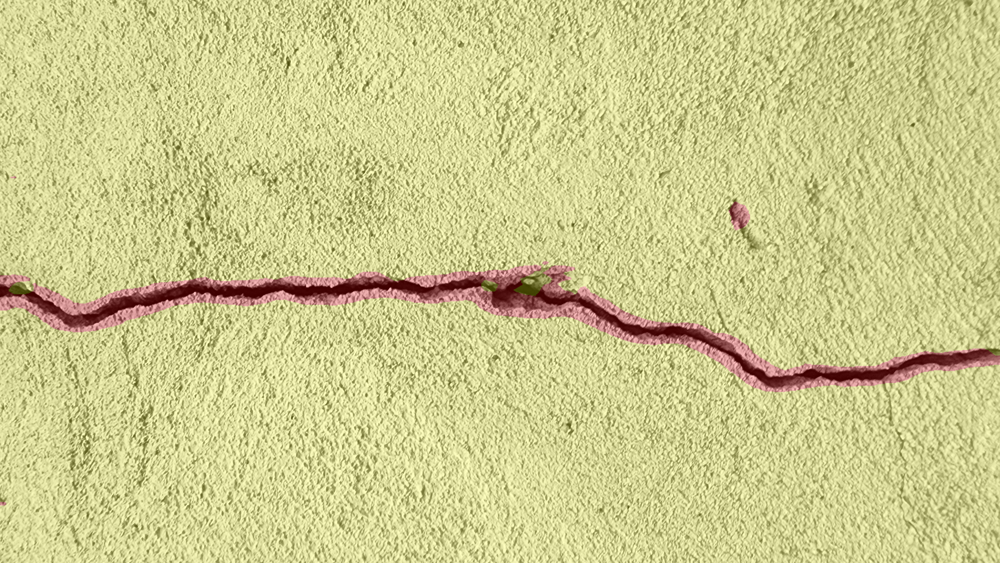

In [8]:
from landingai.visualize import overlay_predictions

predictions = predictor.predict(images[0])
color_map = {
    "Crack": "red",
    "Surface": "yellow",
}
options = {
    "color_map": color_map
}
display(overlay_predictions(predictions, images[0], options=options))

### Post-Processing: Compute the Coverage of Each Class

Now we that have collected a list of predictions (segmentation masks) we can call the `segmentation_class_pixel_coverage()` API to calculate the percentage of the pixel coverage of each class over all the images.

The output (`coverage`) is a dictionary where the key is the predicted class index, and the value is a tuple of the crack percentage and the predicted class name.

The crack percentage is calculated as follow:

`(number of predicted pixels for this class) / (total number of pixels)`

Note: Alternatively, we can also get the absolute coverage value (the number of predicted pixels for each class) by running `segmentation_class_pixel_coverage(predictions, coverage_type='absolute')`. See the API doc in `postprocess.py` for more details.

In [9]:
from landingai.postprocess import segmentation_class_pixel_coverage

coverage = segmentation_class_pixel_coverage(predictions)
coverage

{1: (0.04921181172291297, 'Crack'), 2: (0.950788188277087, 'Surface')}

### Visualize the Predictions in a Pie Chart

Now we that have the crack data, we can process it to see the predictions in a pie chart. However, it would be more reasonable to measure crack size than pie chart.

In [10]:
import matplotlib.pyplot as plt

def generate_pie_chart(data: dict[int, (float, str)], color_map: dict[str, str]) -> None:
    """Generate a pie chart from the crack data"""

    labels = [val[1] for val in data.values()]
    colors = [color_map[label] for label in labels]
    sizes = [val[0] for val in data.values()]
    unclassified_pixels = 1 - sum(sizes)
    sizes.append(unclassified_pixels)
    labels.append("unclassified")
    colors.append("gray")
    _, ax = plt.subplots()
    ax.pie(sizes, labels=labels, colors=colors, autopct="%1.1f%%", shadow=True, startangle=90)

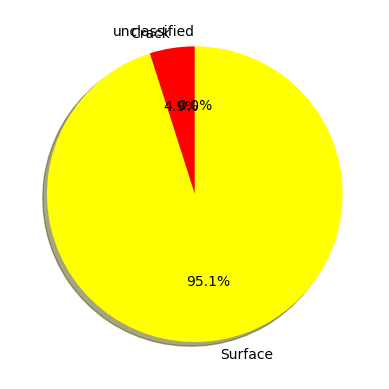

In [11]:
generate_pie_chart(coverage, color_map=color_map)